<a href="https://colab.research.google.com/github/DavidAlexandreTS/Computer-Vision-2020.1/blob/main/Listas/Lista%20I/Lista1_Visao__Computacional.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Visão Computacional - Lista I
  ## David Silva Alexandre

### Questão 1

In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
imagem =cv.imread("kiki.png")

k_size = input("Enter the kernel size:")
k_weight = input("Now, give me the weights:")

a = int(k_size)
b = int(k_weight)

kernel = np.ones((a, a),np.float32)/b

img_filtred = cv.filter2D(imagem,-1,kernel)

plt.subplot(121),plt.imshow(imagem),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(img_filtred),plt.title('Filtered')
plt.xticks([]), plt.yticks([])
plt.show()

cv.imwrite('kikis_filtred.png', img_filtred)

### Questão 2

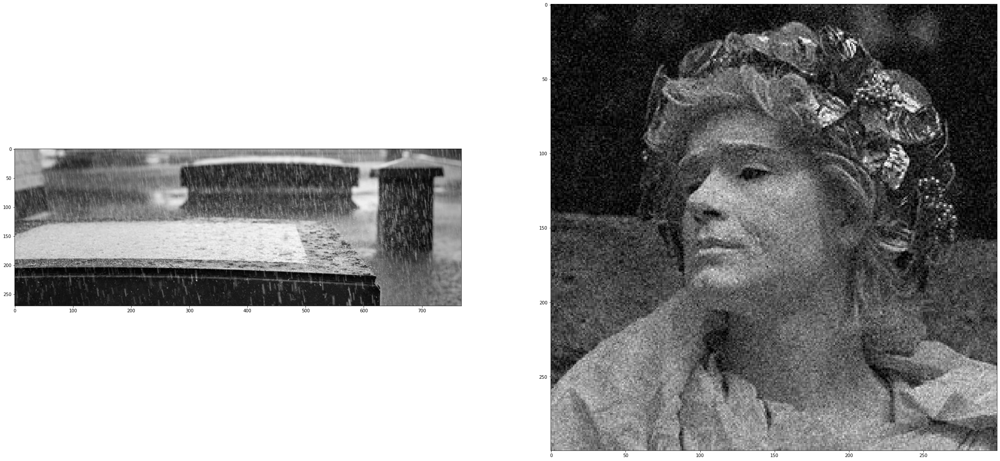

In [ ]:
noise_1 = cv.imread('/content/drive/MyDrive/Coisos/images/rain.jpg', 0)
noise_2= cv.imread('/content/drive/MyDrive/Coisos/images/statue.jpg', 0)

f, axis = plt.subplots(1,2,figsize=(40,25))
axis[0].imshow(noise_1, cmap='gray')
axis[1].imshow(noise_2, cmap='gray')

In [ ]:
def noiseReductionMedianFilter(img, n):
    if n % 2 == 0:
        return 'Kernel dimensions must be odd. '
    
    border_rad = int(n/2)
    
    KERNEL_conv = np.zeros_like((n,n))

    finalMatrix = np.zeros_like(img)

    canvas = np.zeros((img.shape[0] + (n-1), img.shape[1] + (n-1)))
    canvas[border_rad:img.shape[0] + border_rad, border_rad:img.shape[1] + border_rad] = img

    width, height = img.shape[1], img.shape[0]

    for x in range(width):
        for y in range(height):
            KERNEL_conv = np.median(canvas[y: y+n, x:x+n])
            finalMatrix[y,x] = KERNEL_conv
    
    return finalMatrix


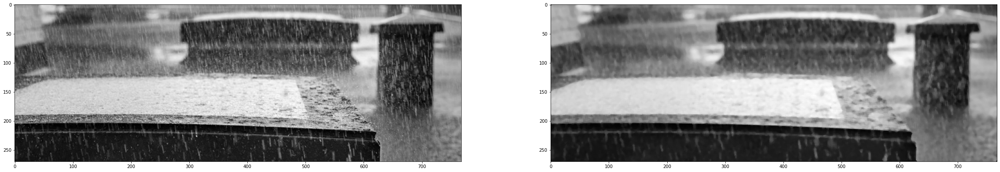

In [ ]:
median_noise = noiseReductionMedianFilter(noise_1, 5)

f, axis = plt.subplots(1,2,figsize=(40,25))
axis[0].imshow(noise_1, cmap='gray')
axis[1].imshow(median_noise, cmap='gray')

In [ ]:
def noiseReductionMeanFilter(img, n):
    """
    n : size of kernel
    """
    if n % 2 == 0:
        return "Kernel dimensions must be odd. "
    
    mean_kernel = np.zeros((n,n)).astype(float) + 1.0
    mean_kernel = mean_kernel * 1/(n*n)

    finalMatrix = convolvefilter(img, mean_kernel)
    return finalMatrix
    

In [ ]:
def convolvefilter(img, kernel):

    if kernel.shape[0] != kernel.shape[1]:
        return "Kernel must be size n x n. "
    if kernel.shape[0] %2 == 0 and kernel.shape[0] != 1:
        return "Kernel n lines and columns must be odd. "
    
    img = img * 1.0
    n = kernel.shape[0]
    border_rad = int(n/2)
    
    KERNEL_conv = np.fliplr(np.flipud(kernel))

    finalMatrix = np.zeros_like(img)

    canvas = np.zeros((img.shape[0] + (n-1), img.shape[1] + (n-1)))
    canvas[border_rad:img.shape[0] + border_rad, border_rad:img.shape[1] + border_rad] = img

    width, height = img.shape[1], img.shape[0]
    for x in range(width):
        for y in range(height):
            finalMatrix[y,x]=(KERNEL_conv * canvas[y: y+n, x: x+n]).sum()
    
    return finalMatrix

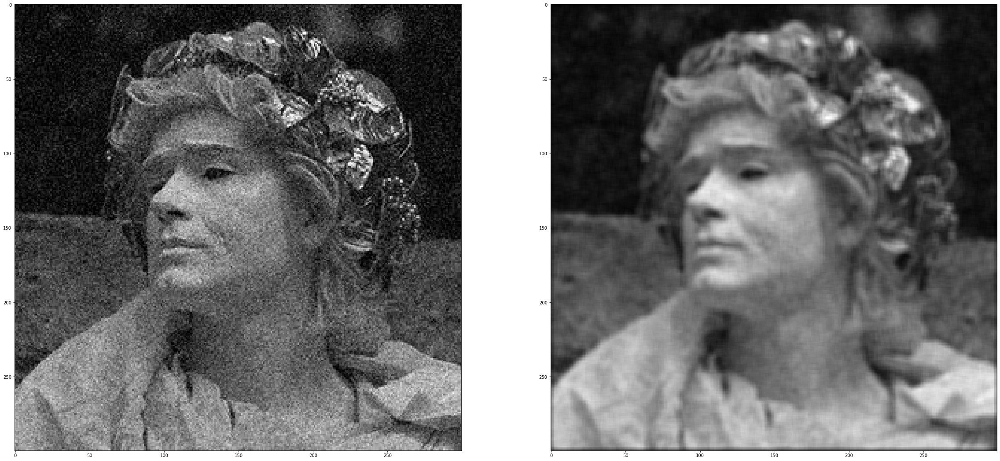

In [ ]:
mean_noise = noiseReductionMeanFilter(noise_2, 5)

f, axis = plt.subplots(1,2,figsize=(40,25))
axis[0].imshow(noise_2, cmap='gray')
axis[1].imshow(mean_noise, cmap='gray')

### Questão 3

In [ ]:
img3 = cv.imread('/content/drive/MyDrive/Coisos/images/driad.jpg', 0)
img4 = cv.imread('/content/drive/MyDrive/Coisos/images/cenarius.jpg', 0)
img5 = cv.imread('/content/drive/MyDrive/Coisos/images/driademaislinda.jpg', 0)

In [ ]:
def highpassfilter(img, n):
    img = img / 255
    
    blurred_img = noiseReductionMeanFilter(img, n)
    img_adapted = convolvefilter(img, np.ones((1,1)))
    
    finalMatrix = img_adapted - blurred_img
    return finalMatrix

Original Images:


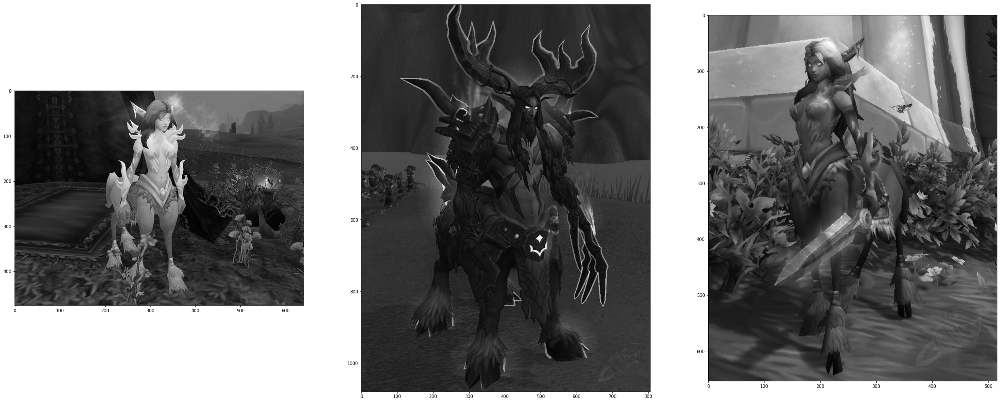

In [ ]:
f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(img3, cmap='gray')
axis[1].imshow(img4, cmap='gray')
axis[2].imshow(img5, cmap='gray')
print('Original Images:')

***Inicialmente para n = 3***

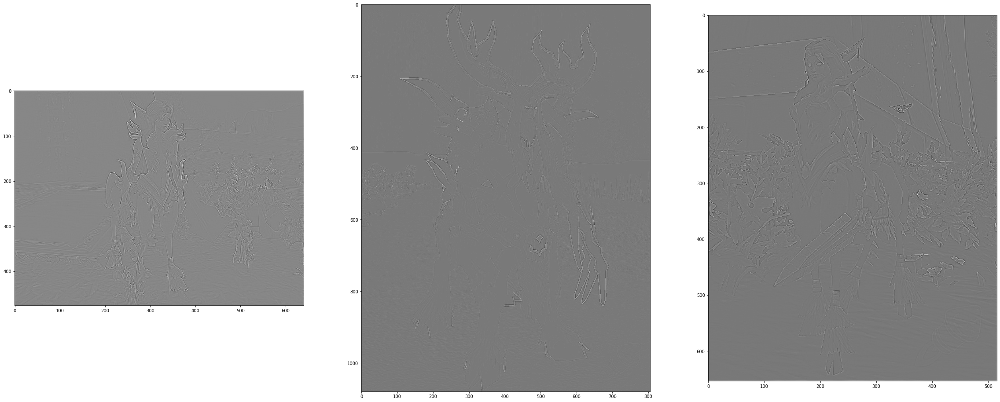

In [ ]:
n = 3

highpass_img3 = highpassfilter(img3, n)
highpass_img4 = highpassfilter(img4, n)
highpass_img5 = highpassfilter(img5, n)

f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(highpass_img3, cmap='gray')
axis[1].imshow(highpass_img4, cmap='gray')
axis[2].imshow(highpass_img5, cmap='gray')

***Agora aumentamos em algumas unidades para observar a mudança, para n = 15 temos:***

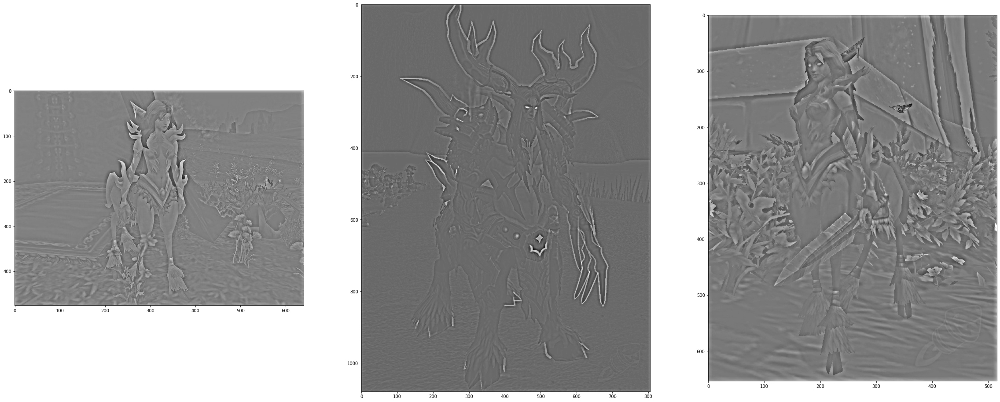

In [ ]:
n = 15

highpass_img3 = highpassfilter(img3, n)
highpass_img4 = highpassfilter(img4, n)
highpass_img5 = highpassfilter(img5, n)

f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(highpass_img3, cmap='gray')
axis[1].imshow(highpass_img4, cmap='gray')
axis[2].imshow(highpass_img5, cmap='gray')

***Quando fazemos n = 45, fica fácil de ver que conforme aumentamos o n, o número de detalhes presente no resultado final aumenta consideravelmente, em outras palavras, os detalhes da imagem ficam cada vez mais evidentes***

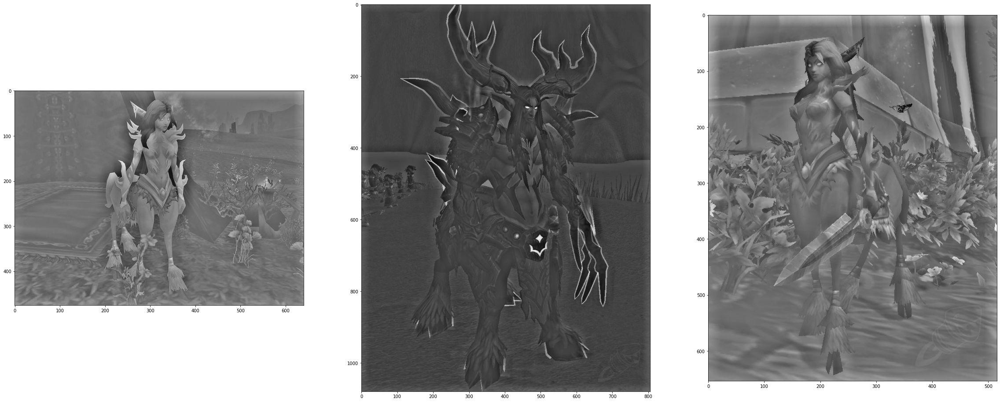

In [ ]:
n = 45

highpass_img3 = highpassfilter(img3, n)
highpass_img4 = highpassfilter(img4, n)
highpass_img5 = highpassfilter(img5, n)

f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(highpass_img3, cmap='gray')
axis[1].imshow(highpass_img4, cmap='gray')
axis[2].imshow(highpass_img5, cmap='gray')

### Questão 4

In [ ]:
def lowpassfilter(img, n):
    finalMatrix = noiseReductionMeanFilter(img, n)
    
    return finalMatrix

Original Images:


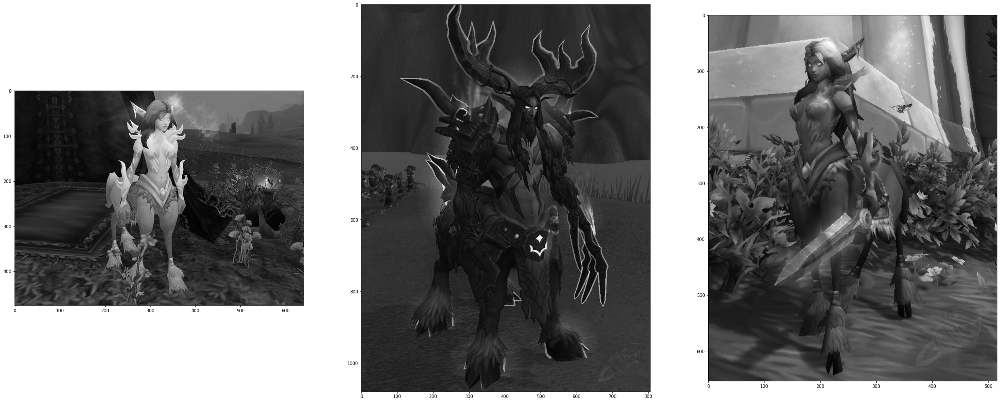

In [ ]:
f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(img3, cmap='gray')
axis[1].imshow(img4, cmap='gray')
axis[2].imshow(img5, cmap='gray')
print('Original Images:')

***Para n = 3, temos***

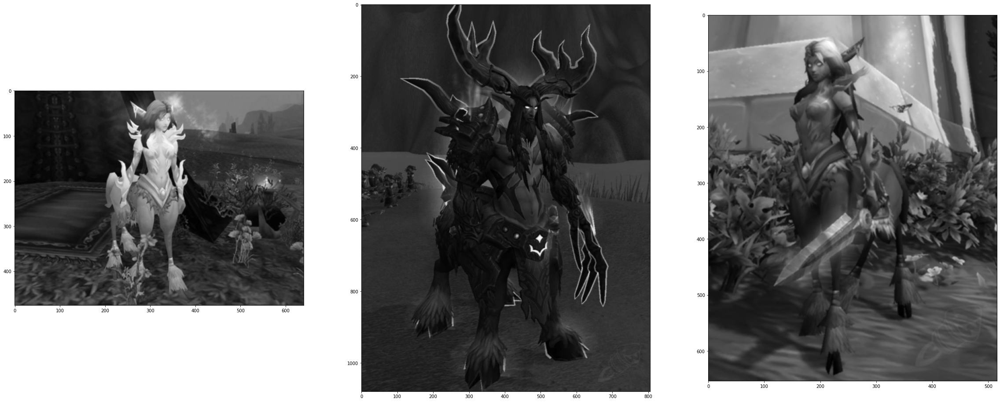

In [ ]:
n = 3

lowpass_img3 = lowpassfilter(img3, n)
lowpass_img4 = lowpassfilter(img4, n)
lowpass_img5 = lowpassfilter(img5, n)

f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(lowpass_img3, cmap='gray')
axis[1].imshow(lowpass_img4, cmap='gray')
axis[2].imshow(lowpass_img5, cmap='gray')

***Para n = 9, já conseguimos notar uma certa diferença***

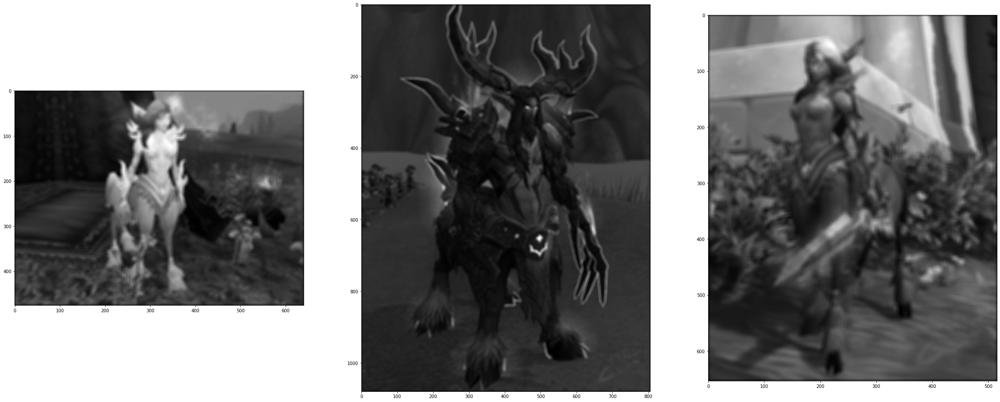

In [ ]:
n = 9

lowpass_img3 = lowpassfilter(img3, n)
lowpass_img4 = lowpassfilter(img4, n)
lowpass_img5 = lowpassfilter(img5, n)

f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(lowpass_img3, cmap='gray')
axis[1].imshow(lowpass_img4, cmap='gray')
axis[2].imshow(lowpass_img5, cmap='gray')

***Para n = 27, notamos que a suavização da imagem fica cada vez mais intensa. Perceba que conforme aumentamos o valor de n neste caso, temos mais suavização e uma relativa perda dos detalhes presentes na imagem***

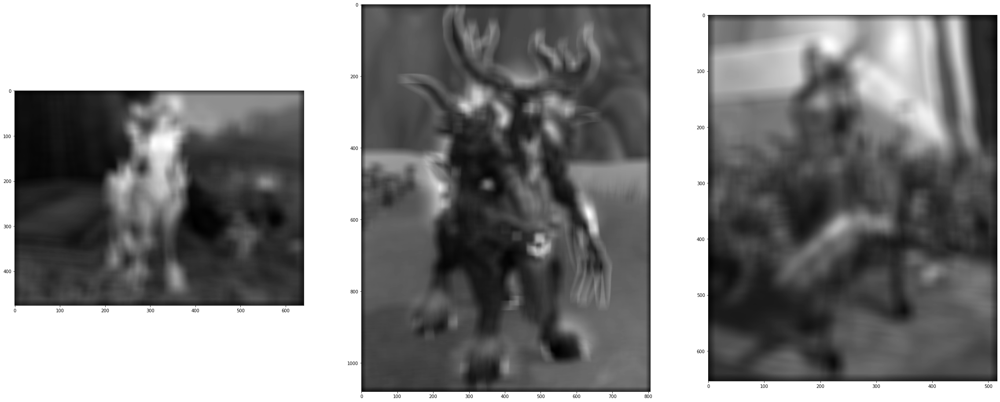

In [ ]:
n = 27

lowpass_img3 = lowpassfilter(img3, n)
lowpass_img4 = lowpassfilter(img4, n)
lowpass_img5 = lowpassfilter(img5, n)

f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(lowpass_img3, cmap='gray')
axis[1].imshow(lowpass_img4, cmap='gray')
axis[2].imshow(lowpass_img5, cmap='gray')

### Questão 5

***Inicialmente para n = 7, temos***

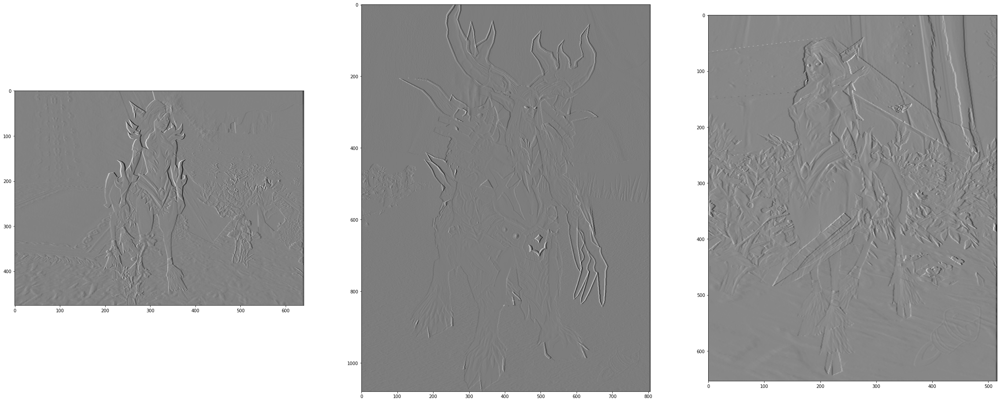

In [ ]:
kernel_dx7 = np.array([[0,0, 0, 0,0,0,0],
                       [0,0, 0, 0,0,0,0],
                       [0,0, 0, 0,0,0,0],
                       [2,2,-2,-2,0,0,0],
                       [0,0, 0, 0,0,0,0],
                       [0,0, 0, 0,0,0,0],
                       [0,0, 0, 0,0,0,0]])

edges_img3 = convolvefilter(img3, kernel_dx7)
edges_img4 = convolvefilter(img4, kernel_dx7)
edges_img5 = convolvefilter(img5, kernel_dx7)

f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(edges_img3, cmap='gray')
axis[1].imshow(edges_img4, cmap='gray')
axis[2].imshow(edges_img5, cmap='gray')

***Agora para n = 11, já somos capazes de notar algumas diferenças. Principalmente em relação as arestas***

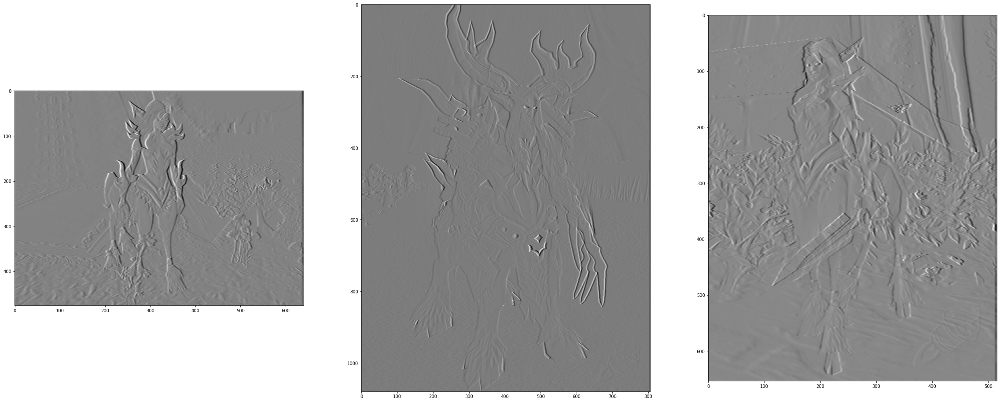

In [ ]:
kernel_dx11 = np.array([
                       [0,0,0, 0, 0, 0,0,0,0,0,0],
                       [0,0,0, 0, 0, 0,0,0,0,0,0],
                       [0,0,0, 0, 0, 0,0,0,0,0,0],
                       [0,0,0, 0, 0, 0,0,0,0,0,0],
                       [0,0,0, 0, 0, 0,0,0,0,0,0],
                       [2,2,2,-2,-2,-2,0,0,0,0,0],
                       [0,0,0, 0, 0, 0,0,0,0,0,0],
                       [0,0,0, 0, 0, 0,0,0,0,0,0],
                       [0,0,0, 0, 0, 0,0,0,0,0,0],
                       [0,0,0, 0, 0, 0,0,0,0,0,0],
                       [0,0,0, 0, 0, 0,0,0,0,0,0]
                       ])

edges_img3_11 = convolvefilter(img3, kernel_dx11)
edges_img4_11 = convolvefilter(img4, kernel_dx11)
edges_img5_11 = convolvefilter(img5, kernel_dx11)

f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(edges_img3_11, cmap='gray')
axis[1].imshow(edges_img4_11, cmap='gray')
axis[2].imshow(edges_img5_11, cmap='gray')

***Por fim, para n = 15 fica evidente que conforme o aumentamos, as arestas ficam cada vez mais explícitas***

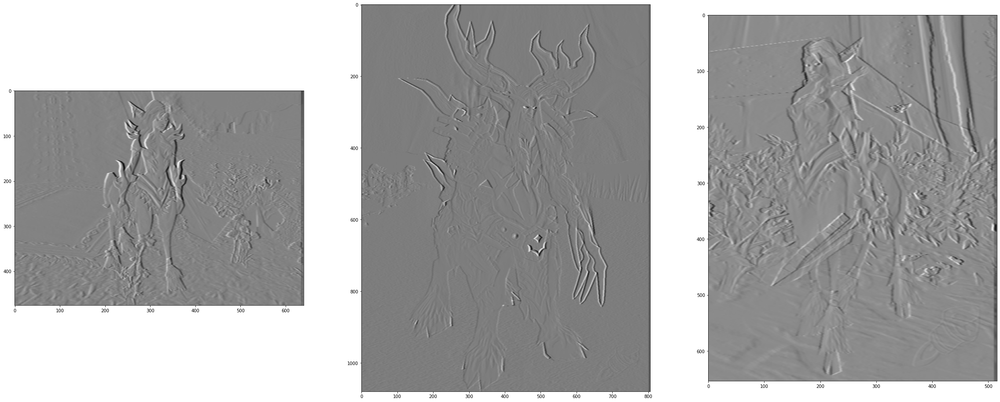

In [ ]:
kernel_dx15 = np.array([
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [2, 2, 2, 2, -2, -2, -2, -2, 0, 0, 0 , 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
                       ])

edges_img3_15 = convolvefilter(img3, kernel_dx15)
edges_img4_15 = convolvefilter(img4, kernel_dx15)
edges_img5_15 = convolvefilter(img5, kernel_dx15)

f, axis = plt.subplots(1,3,figsize=(40,25))
axis[0].imshow(edges_img3_15, cmap='gray')
axis[1].imshow(edges_img4_15, cmap='gray')
axis[2].imshow(edges_img5_15, cmap='gray')

### Questão 6

In [ ]:
def low_pass(n, img):
    kernel = np.ones((n,n),np.float32)/(n*n)
    return cv.filter2D(img,-1,kernel) 

In [ ]:
def high_pass_f(n, im):
  gaussian = cv.GaussianBlur(im,(n,n), cv.COLOR_HSV2RGB)
  gauss_highpass = im - gaussian
  return gauss_highpass

In [ ]:
def hybrid(n, m, img1, img2):
  dst = low_pass(n, img1) + high_pass(m, img2) 
  return dst

In [ ]:
def plotImages(img1, img2, dst):
    f, axarr = plt.subplots(nrows=1,ncols=3, figsize=(12,4))
    plt.sca(axarr[0]); 
    plt.imshow(cv.cvtColor(img1, cv.COLOR_BGR2RGB)); plt.title('Image One')
    plt.sca(axarr[1]); 
    plt.imshow(cv.cvtColor(img2, cv.COLOR_BGR2RGB)); plt.title('Image Two')
    plt.sca(axarr[2]); 
    plt.imshow(cv.cvtColor(dst, cv.COLOR_BGR2RGB)); plt.title('Hybrid')
    plt.show()

In [ ]:
img_eyes = cv.imread('/content/drive/MyDrive/Coisos/images/eyes1.jpg')
img_eyes2 = cv.imread('/content/drive/MyDrive/Coisos/images/eyes2.jpg')

joker_img = cv.imread('/content/drive/MyDrive/Coisos/images/joker.jpeg')
bat_img = cv.imread('/content/drive/MyDrive/Coisos/images/batman.jpg')

byke_img = cv.imread('/content/drive/MyDrive/Coisos/images/byke.jpg')
moto_img = cv.imread('/content/drive/MyDrive/Coisos/images/vrumvrum.jpg')

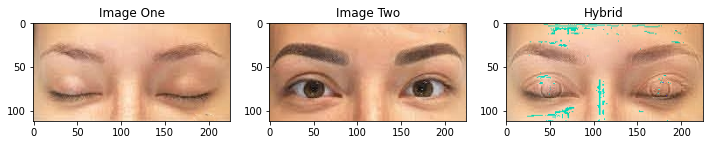

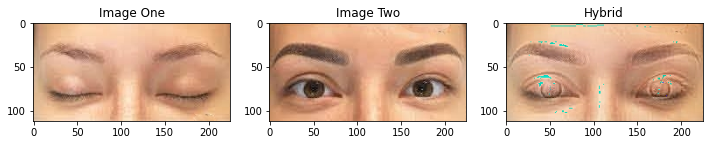

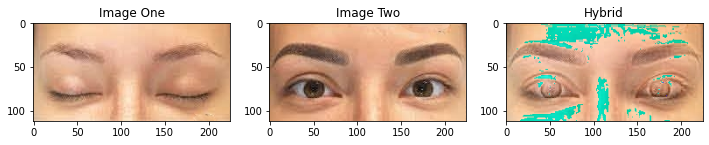

In [ ]:
n = 5
result = hybrid(n, n, img_eyes, img_eyes2)
plotImages(img_eyes, img_eyes2, result)

n = 7
result = hybrid(n, n, img_eyes, img_eyes2)
plotImages(img_eyes, img_eyes2, result)

n = 9
result = hybrid(n, n, img_eyes, img_eyes2)
plotImages(img_eyes, img_eyes2, result)

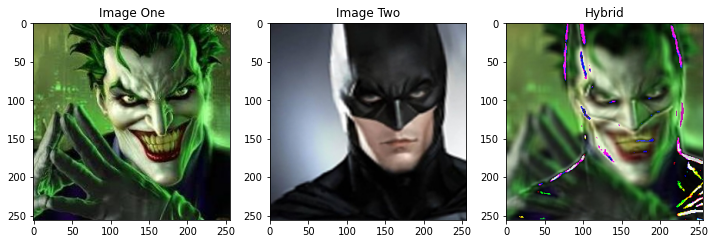

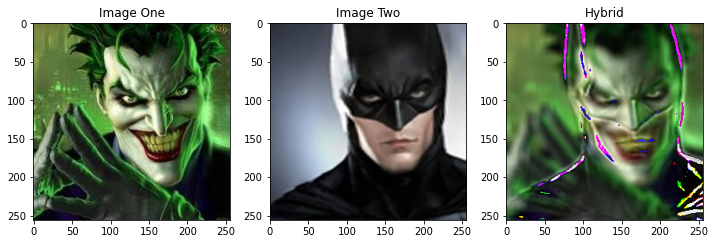

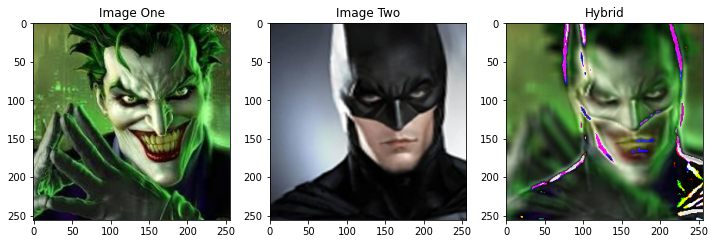

In [ ]:
n = 9
result = hybrid(n, n, joker_img, bat_img)
plotImages(joker_img, bat_img, result)

n = 11
result = hybrid(n, n, joker_img, bat_img)
plotImages(joker_img, bat_img, result)

n = 13
result = hybrid(n, n, joker_img, bat_img)
plotImages(joker_img, bat_img, result)

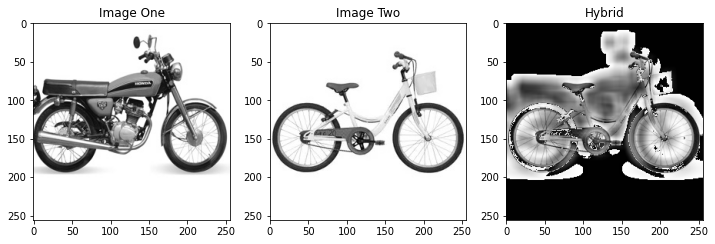

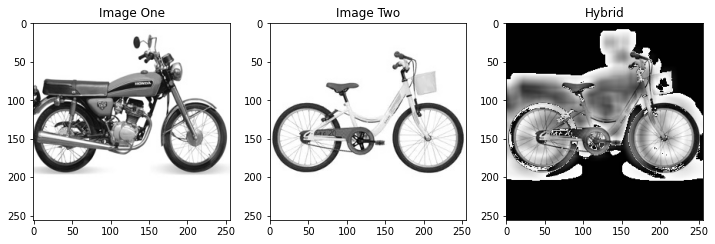

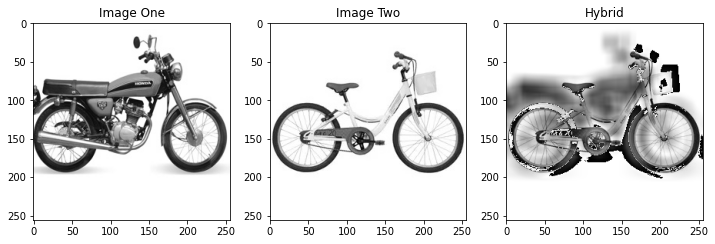

In [ ]:
n = 15
result = hybrid(n, n, moto_img, byke_img)
plotImages(moto_img, byke_img, result)

n = 17
result = hybrid(n, n, moto_img, byke_img)
plotImages(moto_img, byke_img, result)

n = 19
result = hybrid(n, n, moto_img, byke_img)
plotImages(moto_img, byke_img, result)

### Questão 7

In [ ]:
g = np.matrix([[1/273, 4/273, 7/273, 4/273, 1/273], 
              [4/273, 16/273, 26/273, 16/273, 4/273], 
              [7/273, 26/273, 41/273, 26/273, 7/273],
              [4/273, 16/273, 26/273, 16/273, 4/273],
              [1/273, 4/273, 7/273, 4/273, 1/273]])

Img_0 = np.zeros((100, 100))
Img_0[50][50] = 1.0

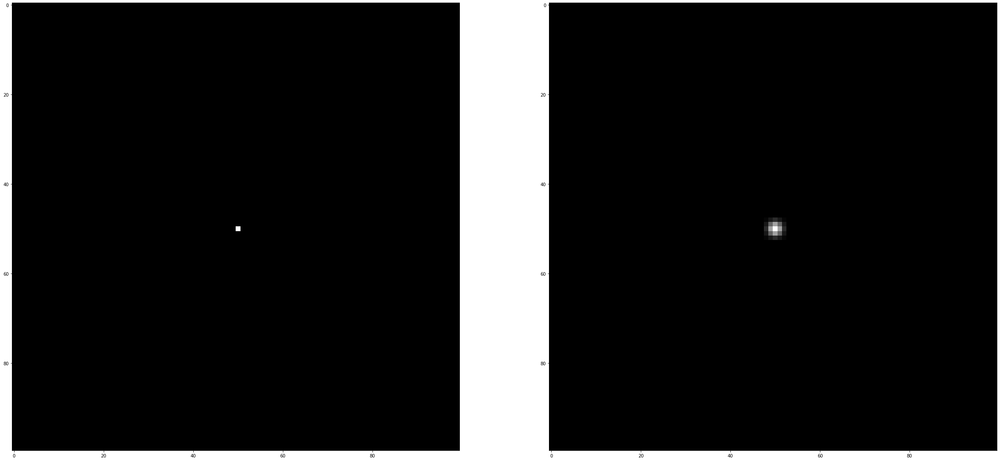

In [ ]:
img_1 = cv.filter2D(Img_0, -1, g)

f, axis = plt.subplots(1,2,figsize=(40,25))
axis[0].imshow(Img_0, cmap='gray')
axis[1].imshow(img_1, cmap='gray')

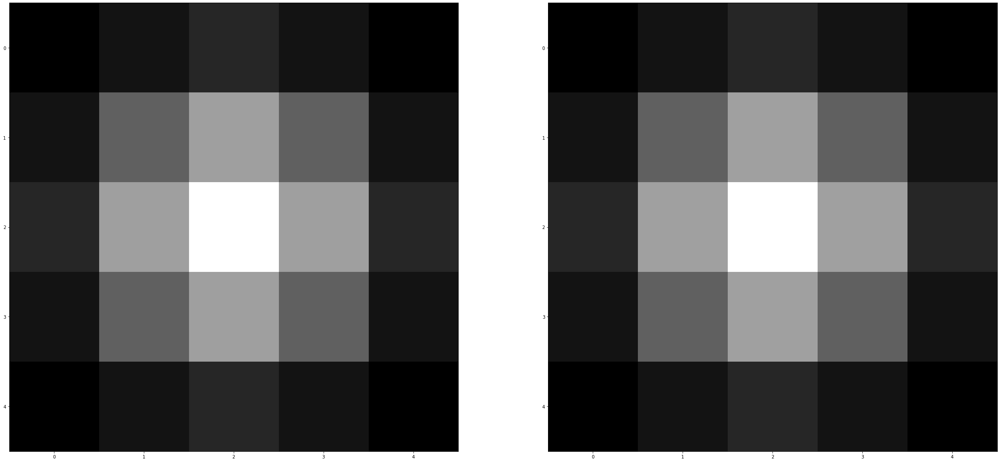

In [ ]:
img_2 = cv.filter2D(g, -1, Img_0)

f, axis = plt.subplots(1, 2, figsize=(40,25))
axis[0].imshow(g, cmap='gray')
axis[1].imshow(img_2, cmap='gray')

### Questão 8

In [ ]:
def resizeimg(img, s):
    width, height = img.shape[1], img.shape[0]
    
    width = int(s * width)
    height = int(s * height)
    
    finalMatrix = cv.resize(img, (width, height), 
                          interpolation= cv.INTER_CUBIC)
    return finalMatrix

In [ ]:
def plot_amazing_girls(dva1, dva2, dva3):
    f, axarr = plt.subplots(nrows=1,ncols=3, figsize=(12,6))
    plt.sca(axarr[0]); 
    plt.imshow(cv.cvtColor(dva1, cv.COLOR_BGR2RGB)); plt.title('Diva I')
    plt.sca(axarr[1]); 
    plt.imshow(cv.cvtColor(dva2, cv.COLOR_BGR2RGB)); plt.title('Diva II')
    plt.sca(axarr[2]); 
    plt.imshow(cv.cvtColor(dva3, cv.COLOR_BGR2RGB)); plt.title('Diva III')
    plt.show()

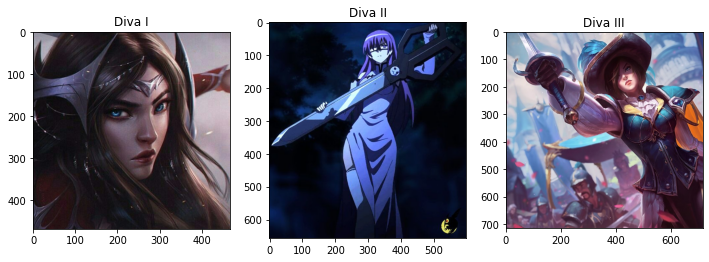

In [ ]:
irelia_img = cv.imread('/content/drive/MyDrive/Coisos/images/irelia.jpg')
shelee_img = cv.imread('/content/drive/MyDrive/Coisos/images/shelee.jpg')
fiora_img = cv.imread('/content/drive/MyDrive/Coisos/images/fiorinha.jpg')

plot_amazing_girls(irelia_img, shelee_img, fiora_img)

In [ ]:
def plot_amazing_girls_resized(dva1, dva2, dva3):
    f, axarr = plt.subplots(nrows=1,ncols=3, figsize=(24,8))
    plt.sca(axarr[0]); 
    plt.imshow(cv.cvtColor(dva1, cv.COLOR_BGR2RGB)); plt.title('Diva I')
    plt.sca(axarr[1]); 
    plt.imshow(cv.cvtColor(dva2, cv.COLOR_BGR2RGB)); plt.title('Diva II')
    plt.sca(axarr[2]); 
    plt.imshow(cv.cvtColor(dva3, cv.COLOR_BGR2RGB)); plt.title('Diva III')
    plt.show()

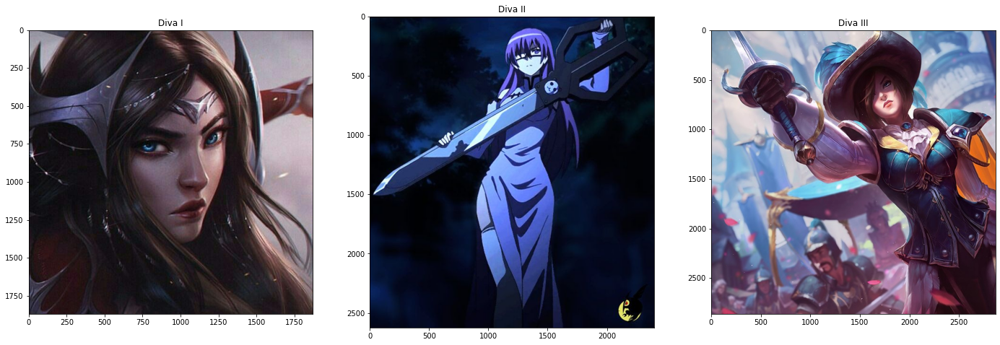

In [ ]:
irelia_bi = resizeimg(irelia_img, 4)
shelee_bi = resizeimg(shelee_img, 4)
fiora_bi = resizeimg(fiora_img, 4)

plot_amazing_girls_resized(irelia_bi, shelee_bi, fiora_bi)

### Questão 9

In [ ]:
def downsample(img):
    m, n = img.shape[0], img.shape[1]
    y = np.arange(0, m, 2, np.int)
    x = np.arange(0, n, 2, np.int)
    a = img[y]
    b = a[:,x,:]
    
    return b         

In [ ]:
def gaussBlur(n, img):

    if(n % 2 == 0):
        n = n + 1

    size = n
    half = int(size/2)
    
    sigma = 0.3*((size-1)*0.5 - 1) + 0.8
    gaussKernel = np.zeros((size, size))
    for x in range(size):
        for y in range(size):
            gaussKernel[x][y] = (1/(2*np.pi*(sigma**2)))*np.exp(-((x-half)**2 + (y-half)**2)/(2*sigma**2))
    
    return cv.filter2D(img, -1, gaussKernel)

In [ ]:
happy_img = cv.imread('/content/drive/MyDrive/Coisos/images/happy.jpg')

i = 0
hg = 0

rw = int(happy_img.shape[0])
cl = int(happy_img.shape[1])

s_down = cv.resize(happy_img, dsize = (0, 0), fx = 1/2, fy = 1/2, interpolation = cv.INTER_NEAREST)

M = np.float32([[1, 0, cl], [0, 1, 0]])
trans = cv.warpAffine(s_down, M, (int(cl*3/2) + 1, rw))
img_result = np.add(trans, cv.warpAffine(happy_img, np.float32([[1,0,0],[0,1,0]]), (int(cl*3/2) + 1, rw)))

while(i < 2):
    s_down = cv.resize(s_down, dsize=(0, 0), fx = 1/2, fy = 1/2, interpolation=cv.INTER_NEAREST)

    i = i + 1
    hg = hg + rw/(2**i)
    M = np.float32([[1, 0, cl],[0, 1, hg]])
    trans = cv.warpAffine(s_down, M, (int(cl*3/2) + 1, rw))
    img_result = np.add(img_result, cv.warpAffine(trans, np.float32([[1,0,0],[0,1,0]]), (int(cl*3/2) + 1, rw)))

In [ ]:
i = 0
hg = 0

s_down = cv.resize(gaussBlur(3, happy_img), dsize = (0, 0), fx = 1/2, fy = 1/2, interpolation = cv.INTER_NEAREST)

M = np.float32([[1, 0, cl],[0, 1, 0]])
trans = cv.warpAffine(s_down, M, (int(cl*3/2) + 1, rw))
img_result_g = np.add(trans, cv.warpAffine(happy_img, np.float32([[1,0,0],[0,1,0]]), (int(cl*3/2) + 1, rw)))

while (i < 2):
    s_down = cv.resize(gaussBlur(3, s_down), dsize=(0, 0), fx = 1/2, fy = 1/2, interpolation=cv.INTER_NEAREST)

    i = i + 1
    hg = hg + rw/(2**i)
    M = np.float32([[1, 0, cl],[0, 1, hg]])
    trans = cv.warpAffine(s_down, M, (int(cl*3/2) + 1, rw))
    img_result_g = np.add(img_result_g, cv.warpAffine(trans, np.float32([[1,0,0],[0,1,0]]), (int(cl*3/2) + 1, rw)))

Original Image:


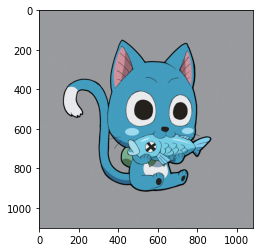

In [ ]:
happy_img = cv.cvtColor(happy_img, cv.COLOR_BGR2RGBA)
plt.imshow(happy_img)
print("Original Image:")

Piramide Downsampling:


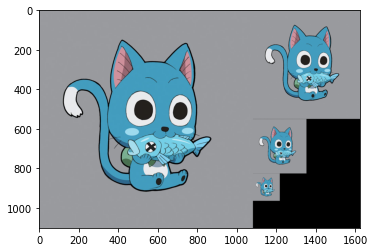

In [ ]:
img_result = cv.cvtColor(img_result, cv.COLOR_BGR2RGBA)
plt.imshow(img_result)
print("Piramide Downsampling:")

Piramide Gaussiana:


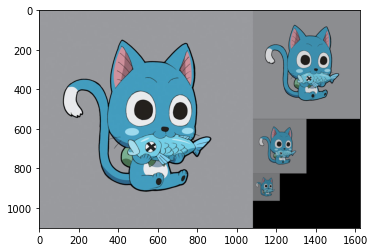

In [ ]:
img_result_g = cv.cvtColor(img_result_g, cv.COLOR_BGR2RGBA)
plt.imshow(img_result_g)
print("Piramide Gaussiana:")

***Comparação:***

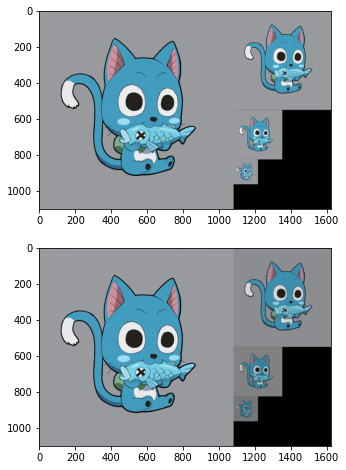

In [ ]:
f, axis = plt.subplots(2,1,figsize=(24, 8))
axis[0].imshow(img_result, cmap='gray')
axis[1].imshow(img_result_g, cmap='gray')

### Questão 10

In [ ]:
def derivateX(img):
    kernel = np.array([[0 ,0 ,0], [0, -1, 1], [0,0,0]], np.int)
    dx = convolution(img, kernel)
    return dx

In [ ]:
def derivateY(img):
    kernel = np.array([[0, 0, 0],[0, -1, 0],[0, 1, 0]], np.int)
    dy = convolution(img, kernel)
    return dy

In [ ]:
def sobelX(img):
    kernel = np.array([[1,0,-1],[2,0,-2],[1,0,-1]], np.int)
    dx = convolution(img, kernel)
    return dx

In [ ]:
def sobelY(img):
    kernel = np.array([[1,2,1],[0,0,0],[-1,-2,-1]], np.int)
    dy = convolution(img, kernel)
    return dy

In [ ]:
def plot_girls(dva1, dva2):
    f, axarr = plt.subplots(nrows=1,ncols=2, figsize=(12,6))
    plt.sca(axarr[0]); 
    plt.imshow(dva1, cmap = 'gray'); plt.title('Diva I')
    plt.sca(axarr[1]); 
    plt.imshow(dva2, cmap = 'gray'); plt.title('Diva II')
    plt.show()

Original Images:


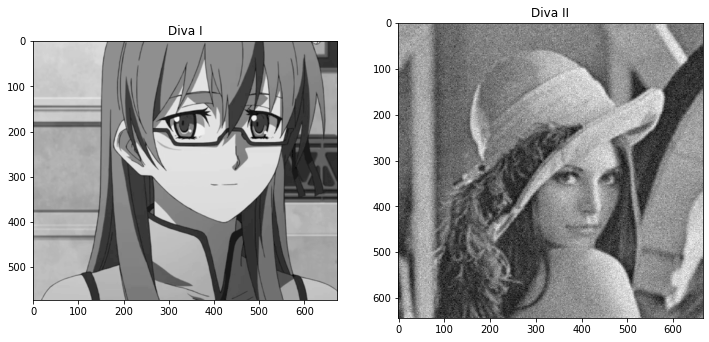

In [ ]:
lady_shelee = cv.imread('/content/drive/MyDrive/Coisos/images/shelees_face.png', 0)
lady_chapeu = cv.imread('/content/drive/MyDrive/Coisos/images/moca_do_chapeu.jpg', 0)
print("Original Images:")
plot_girls(lady_shelee, lady_chapeu)

Derivatives with respect to x


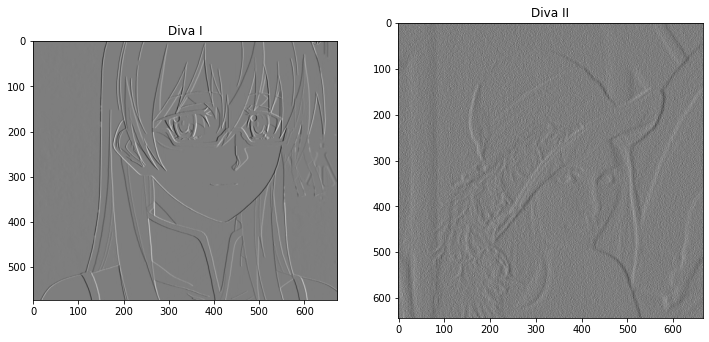

In [ ]:
dx = derivateX(lady_shelee)
d_x = derivateX(lady_chapeu)
print("Derivatives with respect to x")
plot_girls(dx, d_x)

Derivatives with respect to y


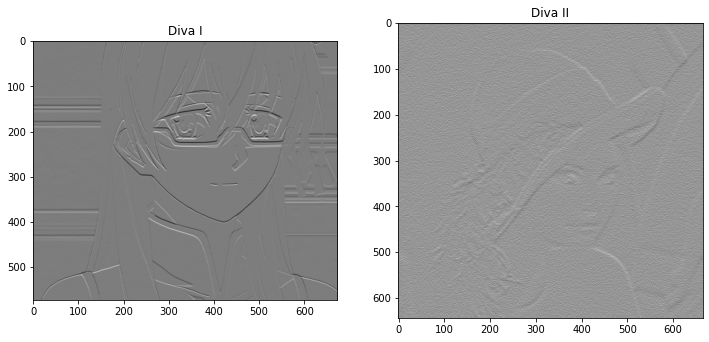

In [ ]:
dy = derivateY(lady_shelee)
d_y = derivateY(lady_chapeu)
print("Derivatives with respect to y")
plot_girls(dy, d_y)

Gradient Magnitude


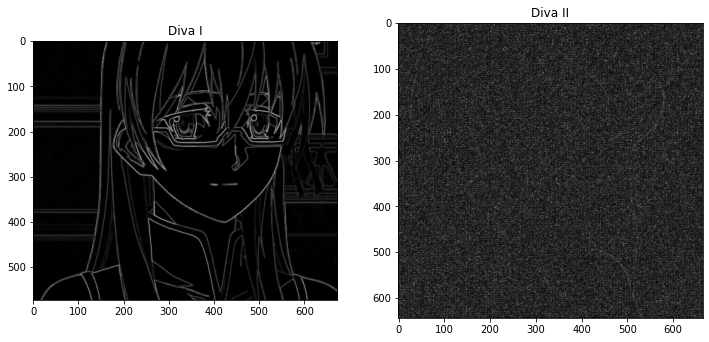

In [ ]:
gn = np.sqrt(np.power(dx, 2) + np.power(dy, 2))
g_n = np.sqrt(np.power(d_x, 2) + np.power(d_y, 2))
print("Gradient Magnitude")
plot_girls(gn, g_n)

Sobel on X


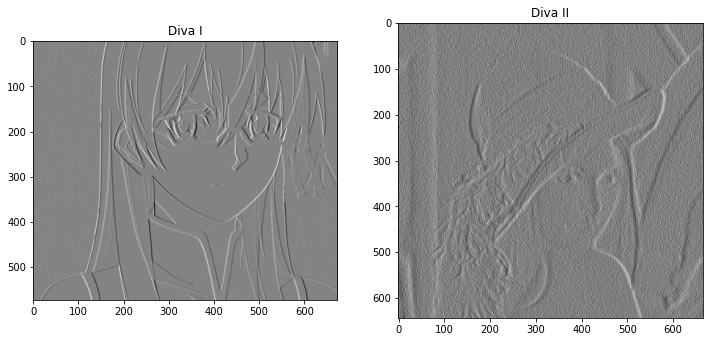

In [ ]:
s_x1 = sobelX(lady_shelee)
s_x2 = sobelX(lady_chapeu)
print("Sobel on X")
plot_girls(s_x1, s_x2)

Sobel on Y


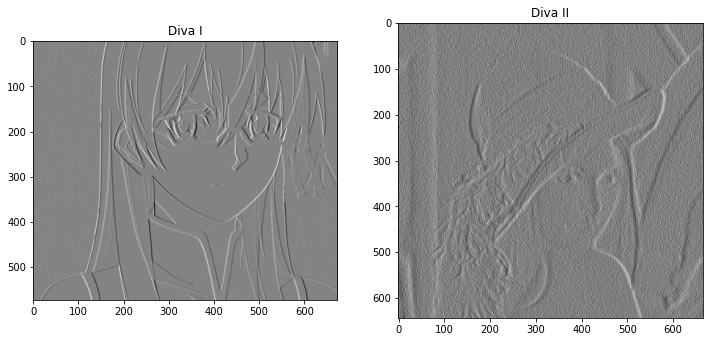

In [ ]:
s_y1 = sobelY(lady_shelee)
s_y2 = sobelY(lady_chapeu)
print("Sobel on Y")
plot_girls(s_x1, s_x2)

Gradient Vector Magnitude


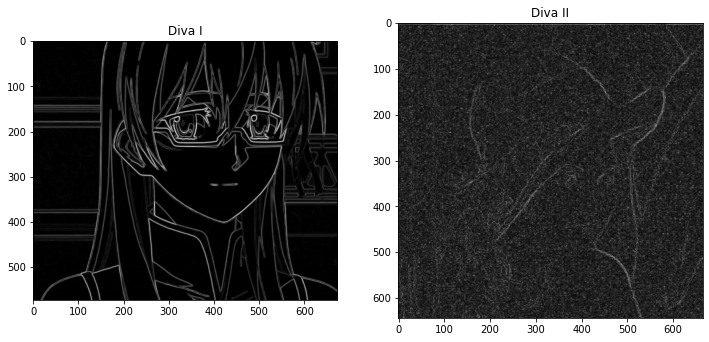

In [ ]:
mag_s1 = np.sqrt(np.power(s_x1, 2) + np.power(s_y1, 2))
mag_s2 = np.sqrt(np.power(s_x2, 2) + np.power(s_y2, 2))
print("Gradient Vector Magnitude")
plot_girls(mag_s1, mag_s2)

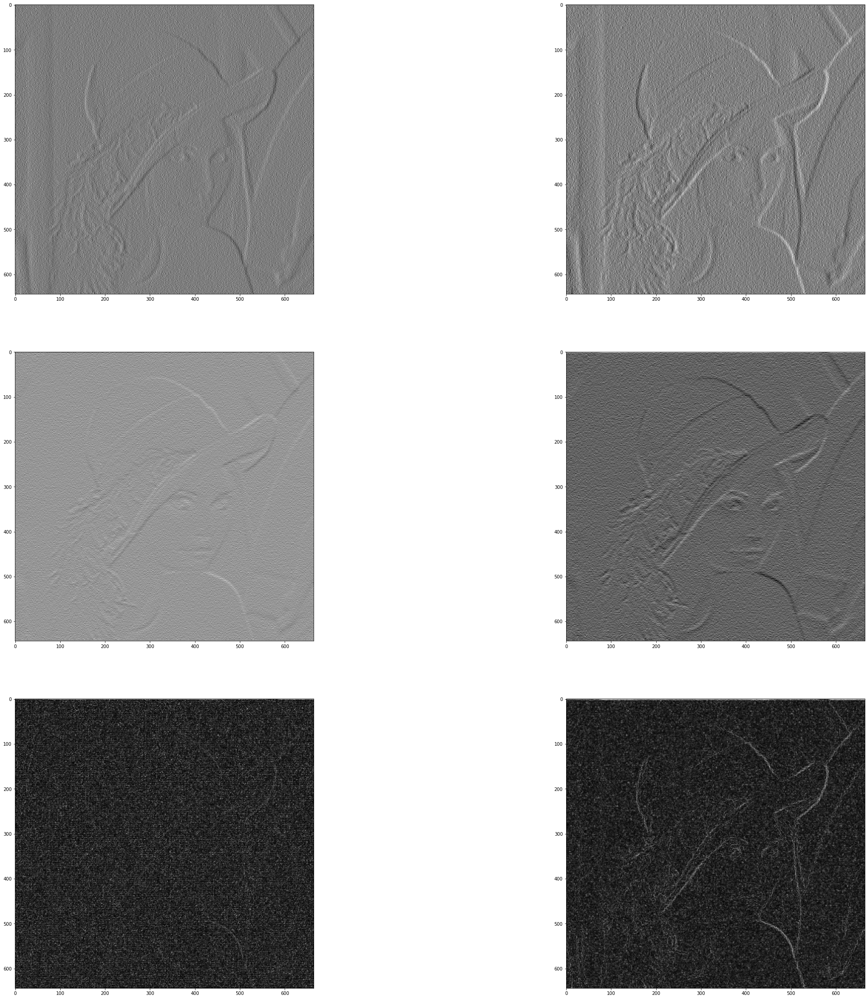

In [ ]:
f, axis = plt.subplots(3,2,figsize=(40, 40))
axis[0][0].imshow(d_x, cmap='gray')
axis[0][1].imshow(s_x2, cmap='gray')
axis[1][0].imshow(d_y, cmap='gray')
axis[1][1].imshow(s_y2, cmap='gray')
axis[2][0].imshow(g_n, cmap='gray')
axis[2][1].imshow(mag_s2, cmap='gray')